## 1. Loading the data
In this sceion, we used modular functions to:
1. Load geospatial data from a shapefile stored in a .zip file using load_geodata()
2. Inspect the dataset by displaying the coordinate reference syste .src and column names
3. Selected the relevant features from the data set using `select_relevant_columns()` to focus the analysis on specific attributes of interest

In [52]:
from tools.preprocessing.a_load_and_inspecting_tools.load_data import load_geodata, select_relevant_columns

zip_path = "data/Classification_Plots.zip"
columns_to_keep = [
    'plotid','sampleid','Uso','Cobertura','Vegetacion','Herbaceas',
    'Pasto_Arb', 'Cultivo','Humedal', 'Terreno','Agua','Otra_clase',
    'SAF','Cambios15_','Gana_Perdi','geometry'
]

# loading the geo data using the .shp file
gdf = load_geodata(zip_path)
display(gdf.crs)
display(gdf.columns)

gdf1 = select_relevant_columns(gdf, columns_to_keep)


<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

Index(['Source.Nam', 'plotid', 'sampleid', 'lon', 'lat', 'sample_geo', 'Uso',
       'Cobertura', 'Vegetacion', 'Herbaceas', 'Pasto_Arb', 'Cultivo',
       'Humedal', 'Terreno', 'Agua', 'Otra_clase', 'SAF', 'Cambios15_',
       'Gana_Perdi', 'geometry'],
      dtype='object')

CRS Info: EPSG:4326 (WGS 84) <br>
- This is a global geographic coordinate system using **latitude** and **longitude** in degrees.  
- Based on the **WGS 84 datum**, which is the same system used by GPS.  
- The coordinate system covers the entire globe:  
`(-180°, -90°)` : `(+180°, +90°)`  
- Prime Meridian: **Greenwich**  
- Suitable for global data, but not ideal for measuring distances (use projected CRS like UTM for that).

About the output:
- The dataset uses a valid geographic coordinate reference system (CRS)
- We can see the columns that are present in the shapefile
- We succesufully filtered the GeoDataFrame to include only relevant spatial and categorical attributes for analysis

## 2. Handling Missing Categorical Data
Filling missing values in categorical columns with "No_Applicable" to ensure data consistency before analysis or encoding


In [53]:
from tools.preprocessing.b_handle_missing_data_tools.categorical_cleaning import fill_missing_categorical

# spanish columns
sp_columns_to_replace = ['Uso', 'Cobertura', 'Vegetacion', 'Herbaceas', 'Pasto_Arb',
                         'Cultivo', 'Humedal', 'Terreno', 'Agua', 'Otra_clase',
                         'SAF', 'Cambios15_', 'Gana_Perdi']

# fill NA values in Spanish columns
gdf1 = fill_missing_categorical(gdf1, sp_columns_to_replace, fill_value="No_Aplicable")

# optional: display columns with NA values (should be zero)
print(gdf1.isna().sum())


plotid        0
sampleid      0
Uso           0
Cobertura     0
Vegetacion    0
Herbaceas     0
Pasto_Arb     0
Cultivo       0
Humedal       0
Terreno       0
Agua          0
Otra_clase    0
SAF           0
Cambios15_    0
Gana_Perdi    0
geometry      0
dtype: int64


About the output: <br>
- The list of column names shows the GeoDataFrame includes spatial and categorical attributes (e.g., `Uso`, `Cobertura`, `SAF`).
- The NA count confirms that missing values in selected Spanish categorical columns have been successfully replaced with `"No_Aplicable"`.

In [54]:
rows, cols = gdf.shape
print(f"GeoDataFrame has {rows} rows and {cols} columns.")

# gdf1.columns

GeoDataFrame has 101160 rows and 20 columns.


## 3. Visualizing the spatial distribution with Folium
Downsample the geospatial data and plot locations as circle markers on an interactive map

In [55]:
from tools.visualization.a_folium_mapping import downsample_gdf, create_folium_map

downsampled_gdf = downsample_gdf(gdf1, step=9)
map_ = create_folium_map(downsampled_gdf)
display(map_)

In [56]:
import numpy as np
import folium

cplot_index=np.arange(4,gdf.shape[0],9) # select the plot center using row indecies (center plot starts at 4 and then can be selected based on every ninth record)
plt_center=gdf.iloc[cplot_index] #select all plots from the plot subplots gdf

#display the results using geopandas explore function (uses folium). Note we have not used geemap yet.
m=gdf.iloc[:18].explore(color='red',name='subplots') # pull out the first two plots and subplots (9*2=18)
m=plt_center.explore(m=m,name='Plot center')
folium.LayerControl().add_to(m)
m

## 4. Using medoid values to describe points numerically 
We extracted the medoid values for each point. The medoid values help describe the point numerically [gee extraction](John-CostaRica.ipynb)
In this new dataframe we have 24 new columns which makes the geodataframe 101160 x 44. These new columns come from data engineering from our existing features using raster tools and google earth engine

The new colums include: 
- `BLUE` 
- `GREEN`
- `NIR`
- `RED`
- `SWIR1`
- `SWIR2`
- `altura2`
- `aspect`
- `aspectcos`
- `aspectdeg`
- `aspectsin`
- `brightness`
- `clay_1mMed` 
- `diff`
- `elevation` 
- `evi`
- `fpar`
- `hand30_100`
- `lai`
- `mTPI`
- `ndvi`
- `ocs_1mMed`
- `sand_1mMed`
- `savi`
- `silt_1mMed`
- `slope`
- `topDiv`
- `wetness`

In [57]:
# The output of John's Code (Spanish version)
import geopandas as gpd
gdf2 = gpd.read_parquet('./data/en_basic_gee_data.parquet')
gdf2.head()

,plotid,sampleid,Use,CoverType,Vegetations,Herbaceous,GrasslandShrub,CropsType,WetlandArea,LandType,...,lai,mTPI,ndvi,ocs_1mMed,sand_1mMed,savi,silt_1mMed,slope,topDiv,wetness
9,2902,11605,Wetlands,Vegetation,Trees,Not_Applicable,Not_Applicable,Not_Applicable,Swamp (Marsh),Not_Applicable,...,0.305,8129.0,0.799771,68.0,332.15,0.393728,298.85,0.927410,1323.685053,-0.006312
12,2902,11608,Grasslands,Vegetation,Herbaceous plants,Grasses,Mixed Pasture (70-90%),Not_Applicable,Not_Applicable,Not_Applicable,...,0.305,8129.0,0.796553,68.0,332.15,0.423713,298.85,2.935819,1323.685053,-0.014932
13,2902,11609,Wetlands,Vegetation,Herbaceous plants,Grasses,Not_Applicable,Not_Applicable,Swamp (Marsh),Not_Applicable,...,0.260,8129.0,0.644415,65.0,340.45,0.380250,304.70,0.944368,1323.685053,-0.001697
15,2902,11611,Grasslands,Vegetation,Herbaceous plants,Grasses,Mixed Pasture (70-90%),Not_Applicable,Not_Applicable,Not_Applicable,...,0.305,8129.0,0.784331,68.0,332.15,0.512687,298.85,0.927410,1323.685053,-0.027987
16,2902,11612,Wetlands,Vegetation,Trees,Not_Applicable,Not_Applicable,Not_Applicable,Swamp (Marsh),Not_Applicable,...,0.260,8129.0,0.769357,65.0,340.45,0.360428,304.70,2.645556,1323.685053,-0.009912


In [58]:
gdf2.columns

Index(['plotid', 'sampleid', 'Use', 'CoverType', 'Vegetations', 'Herbaceous',
       'GrasslandShrub', 'CropsType', 'WetlandArea', 'LandType',
       'WaterBodyType', 'OtherClass', 'SAF', 'Changes_15', 'Gain_Loss',
       'geometry', 'BLUE', 'GREEN', 'NIR', 'RED', 'SWIR1', 'SWIR2', 'altura2',
       'aspect', 'aspectcos', 'aspectdeg', 'aspectsin', 'brightness',
       'clay_1mMed', 'diff', 'elevation', 'evi', 'fpar', 'hand30_100', 'lai',
       'mTPI', 'ndvi', 'ocs_1mMed', 'sand_1mMed', 'savi', 'silt_1mMed',
       'slope', 'topDiv', 'wetness'],
      dtype='object')

## 5. Inspecting the missing values in the new geodataframe 

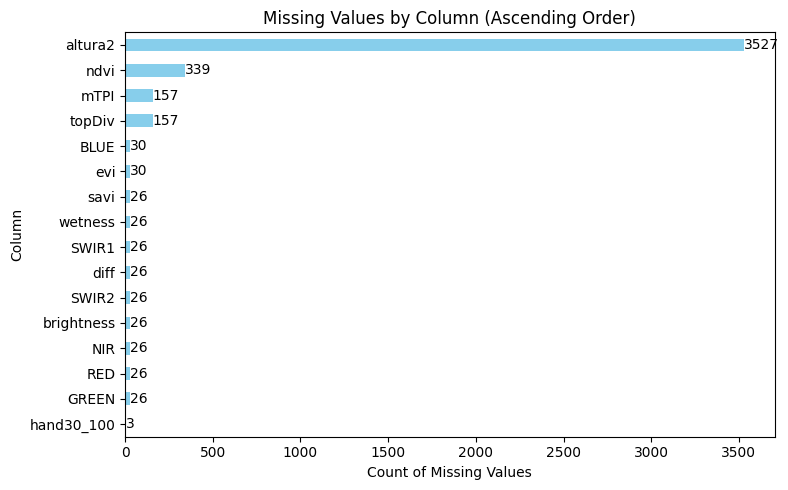

In [59]:
from tools.visualization.c_missing_values import plot_missing_values

plot_missing_values(gdf2)

### Inspecting the data type for each feature in the new GeoDataFrame

In [60]:
from collections import defaultdict

# Group columns by their dtype
dtypes_grouped = defaultdict(list)
for col, dtype in gdf2.dtypes.items():
    dtypes_grouped[str(dtype)].append(col)

# Display grouped columns
for dtype, cols in dtypes_grouped.items():
    print(f"\n * {dtype} ({len(cols)} columns):")
    print(cols)



 * int64 (2 columns):
['plotid', 'sampleid']

 * object (13 columns):
['Use', 'CoverType', 'Vegetations', 'Herbaceous', 'GrasslandShrub', 'CropsType', 'WetlandArea', 'LandType', 'WaterBodyType', 'OtherClass', 'SAF', 'Changes_15', 'Gain_Loss']

 * geometry (1 columns):
['geometry']

 * float64 (28 columns):
['BLUE', 'GREEN', 'NIR', 'RED', 'SWIR1', 'SWIR2', 'altura2', 'aspect', 'aspectcos', 'aspectdeg', 'aspectsin', 'brightness', 'clay_1mMed', 'diff', 'elevation', 'evi', 'fpar', 'hand30_100', 'lai', 'mTPI', 'ndvi', 'ocs_1mMed', 'sand_1mMed', 'savi', 'silt_1mMed', 'slope', 'topDiv', 'wetness']


About the output: <br>
It seems like we have noticibly a lot of missing values in `altura2` and also in `ndvi` which happen to be continous variables in the geodataframe


## 6. Imputing Numerical/Continous variables with their mean value

In [61]:
from tools.preprocessing.b_handle_missing_data_tools.continous_imputation import fill_missing_numeric

# numeric_cols_with_na = ['BLUE', 'GREEN', 'NIR', 'RED', 'SWIR1', 'SWIR2', 'altura2', 'brightness', 'diff', 'evi', 'hand30_100','mTPI', 'ndvi', 'savi', 'topDiv','wetness']
# gdf2 = fill_missing_numeric(gdf2, numeric_cols_with_na, method="mean")

gdf2.loc[gdf2['altura2'].isna(), 'altura2'] = 0 # setting nas for altura2 to 0s 
gdf2['altura2']
gdf3 = gdf2.dropna()

In [62]:
# prints the NA count for column with NA values
na_count = gdf3.isna().sum()
print(na_count[na_count > 0])

Series([], dtype: int64)


In [63]:
gdf3.head()

,plotid,sampleid,Use,CoverType,Vegetations,Herbaceous,GrasslandShrub,CropsType,WetlandArea,LandType,...,lai,mTPI,ndvi,ocs_1mMed,sand_1mMed,savi,silt_1mMed,slope,topDiv,wetness
9,2902,11605,Wetlands,Vegetation,Trees,Not_Applicable,Not_Applicable,Not_Applicable,Swamp (Marsh),Not_Applicable,...,0.305,8129.0,0.799771,68.0,332.15,0.393728,298.85,0.927410,1323.685053,-0.006312
12,2902,11608,Grasslands,Vegetation,Herbaceous plants,Grasses,Mixed Pasture (70-90%),Not_Applicable,Not_Applicable,Not_Applicable,...,0.305,8129.0,0.796553,68.0,332.15,0.423713,298.85,2.935819,1323.685053,-0.014932
13,2902,11609,Wetlands,Vegetation,Herbaceous plants,Grasses,Not_Applicable,Not_Applicable,Swamp (Marsh),Not_Applicable,...,0.260,8129.0,0.644415,65.0,340.45,0.380250,304.70,0.944368,1323.685053,-0.001697
15,2902,11611,Grasslands,Vegetation,Herbaceous plants,Grasses,Mixed Pasture (70-90%),Not_Applicable,Not_Applicable,Not_Applicable,...,0.305,8129.0,0.784331,68.0,332.15,0.512687,298.85,0.927410,1323.685053,-0.027987
16,2902,11612,Wetlands,Vegetation,Trees,Not_Applicable,Not_Applicable,Not_Applicable,Swamp (Marsh),Not_Applicable,...,0.260,8129.0,0.769357,65.0,340.45,0.360428,304.70,2.645556,1323.685053,-0.009912


In [64]:
# Count duplicates
print("Duplicate plotid entries:", gdf2['plotid'].duplicated().sum())
print("Duplicate sampleid entries:", gdf2['sampleid'].duplicated().sum())


Duplicate plotid entries: 81425
Duplicate sampleid entries: 43945


In [65]:
import numpy as np

display(gdf3['plotid'].describe()) #summary stats for response
display((gdf3['plotid'].isna()).sum())
df_gr = gdf3.groupby('plotid')
cnt_sampleid = df_gr.agg('size')
display(np.unique(cnt_sampleid)) #display how many sampleid records are in each plotid
display(cnt_sampleid[cnt_sampleid > 9]) #display which plots have more than 9 records
display(gdf2.loc[gdf2['plotid'] == 1630]) #select just plot 1630 which sampleid to use

count     91421.000000
mean      80849.438783
std      249891.347063
min           2.000000
25%        2808.000000
50%        5577.000000
75%        8359.000000
max      910231.000000
Name: plotid, dtype: float64

np.int64(0)

array([1, 2, 3, 4, 5, 6, 7, 8, 9])

Series([], dtype: int64)

,plotid,sampleid,Use,CoverType,Vegetations,Herbaceous,GrasslandShrub,CropsType,WetlandArea,LandType,...,lai,mTPI,ndvi,ocs_1mMed,sand_1mMed,savi,silt_1mMed,slope,topDiv,wetness
89532,1630,6517,Agriculture,Vegetation,Herbaceous plants,Other Herbaceous,Not_Applicable,Sugarcane,Not_Applicable,Not_Applicable,...,0.08,8129.0,0.292445,52.0,286.75,0.194740,348.30,1.322494,1323.661862,-0.200940
89534,1630,6518,Agriculture,Vegetation,Herbaceous plants,Other Herbaceous,Not_Applicable,Sugarcane,Not_Applicable,Not_Applicable,...,0.08,8129.0,0.298658,52.0,286.75,0.184348,348.30,1.854334,1323.661862,-0.188596
89536,1630,6519,Agriculture,Vegetation,Herbaceous plants,Other Herbaceous,Not_Applicable,Sugarcane,Not_Applicable,Not_Applicable,...,0.08,8129.0,0.312833,52.0,286.75,0.195779,348.30,1.854334,1323.661862,-0.193918
89539,1630,6520,Agriculture,Vegetation,Herbaceous plants,Other Herbaceous,Not_Applicable,Sugarcane,Not_Applicable,Not_Applicable,...,0.08,8129.0,0.292577,52.0,286.75,0.190970,348.30,0.942981,1323.662105,-0.191193
89541,1630,6521,Agriculture,Vegetation,Herbaceous plants,Other Herbaceous,Not_Applicable,Sugarcane,Not_Applicable,Not_Applicable,...,0.08,8129.0,0.301933,52.0,286.75,0.196495,348.30,2.974677,1323.662105,-0.200302
89543,1630,6522,Agriculture,Vegetation,Herbaceous plants,Other Herbaceous,Not_Applicable,Sugarcane,Not_Applicable,Not_Applicable,...,0.08,8129.0,0.301598,52.0,286.75,0.198600,348.30,2.974679,1323.662105,-0.204489
89544,1630,6523,Agriculture,Vegetation,Herbaceous plants,Other Herbaceous,Not_Applicable,Sugarcane,Not_Applicable,Not_Applicable,...,0.08,8129.0,0.322541,52.0,294.40,0.211323,380.75,0.942981,1323.662105,-0.183218
89546,1630,6524,Agriculture,Vegetation,Herbaceous plants,Other Herbaceous,Not_Applicable,Sugarcane,Not_Applicable,Not_Applicable,...,0.08,8129.0,0.320008,52.0,294.40,0.202978,380.75,2.780288,1323.662105,-0.196244
89549,1630,6525,Agriculture,Vegetation,Herbaceous plants,Other Herbaceous,Not_Applicable,Sugarcane,Not_Applicable,Not_Applicable,...,0.08,8129.0,0.322724,52.0,294.40,0.207067,380.75,1.322496,1323.662105,-0.196752


## 7. Addressing the Duplicates

Inspired by one of the notebooks shared by one of our mentors, we decided to address the duplicated (QAQC) plots using the first sample collected.

For more information, you can click on this [link](https://github.com/Goldferret/NDMN-Notebooks/blob/main/CostaRica-Notebook/templates/Summarizing_plot_data.ipynb). (Summarizing  plot data)


### Addresing the duplicated `sampleids`

In [66]:
gdf4=gdf3.groupby(['plotid','sampleid']).first()#make sure to group on both plotid and sampleid to get all unique combinations
gdf4

Use   CoverType        Vegetations      Herbaceous  \
plotid sampleid                                                              
2      5         Grasslands  Vegetation  Herbaceous plants         Grasses   
       6         Grasslands  Vegetation  Herbaceous plants         Grasses   
       7             Forest  Vegetation              Trees  Not_Applicable   
       8         Grasslands  Vegetation  Herbaceous plants         Grasses   
       9             Forest  Vegetation              Trees  Not_Applicable   
...                     ...         ...                ...             ...   
910231 3640925       Forest  Vegetation              Trees  Not_Applicable   
       3640926     Wetlands       Water     Not_Applicable  Not_Applicable   
       3640927       Forest  Vegetation              Trees  Not_Applicable   
       3640928       Forest  Vegetation              Trees  Not_Applicable   
       3640929     Wetlands       Water     Not_Applicable  Not_Applicable   

                         GrasslandShrub       CropsType     WetlandArea  \
plotid sampleid                                                           
2      5         Pure Pasture (90-100%)  Not_Applicable  Not_Applicable   
       6         Pure Pasture (90-100%)  Not_Applicable  Not_Applicable   
       7                 Not_Applicable  Not_Applicable  Not_Applicable   
       8         Pure Pasture (90-100%)  Not_Applicable  Not_Applicable   
       9                 Not_Applicable  Not_Applicable  Not_Applicable   
...                                 ...             ...             ...   
910231 3640925           Not_Applicable  Not_Applicable  Not_Applicable   
       3640926           Not_Applicable  Not_Applicable    Water bodies   
       3640927           Not_Applicable  Not_Applicable  Not_Applicable   
       3640928           Not_Applicable  Not_Applicable  Not_Applicable   
       3640929           Not_Applicable  Not_Applicable    Water bodies   

                       LandType   WaterBodyType      OtherClass  ...    lai  \
plotid sampleid                                                  ...          
2      5         Not_Applicable  Not_Applicable  Not_Applicable  ...  0.295   
       6         Not_Applicable  Not_Applicable  Not_Applicable  ...  0.295   
       7         Not_Applicable  Not_Applicable  Not_Applicable  ...  0.295   
       8         Not_Applicable  Not_Applicable  Not_Applicable  ...  0.295   
       9         Not_Applicable  Not_Applicable  Not_Applicable  ...  0.295   
...                         ...             ...             ...  ...    ...   
910231 3640925   Not_Applicable  Not_Applicable  Not_Applicable  ...  0.595   
       3640926   Not_Applicable     Continental  Not_Applicable  ...  0.595   
       3640927   Not_Applicable  Not_Applicable  Not_Applicable  ...  0.595   
       3640928   Not_Applicable  Not_Applicable  Not_Applicable  ...  0.595   
       3640929   Not_Applicable     Continental  Not_Applicable  ...  0.595   

                   mTPI      ndvi ocs_1mMed  sand_1mMed      savi  silt_1mMed  \
plotid sampleid                                                                 
2      5         8170.0  0.687111      55.0      292.90  0.337061       312.2   
       6         8128.0  0.586939      55.0      292.90  0.373690       312.2   
       7         8128.0  0.772427      55.0      292.90  0.453859       312.2   
       8         8170.0  0.590017      55.0      292.90  0.319073       312.2   
       9         8128.0  0.744990      55.0      292.90  0.385159       312.2   
...                 ...       ...       ...         ...       ...         ...   
910231 3640925   8127.0  0.931607      61.0      241.35  0.542267       390.8   
       3640926   8129.0  0.218692      57.0      218.95  0.016753       378.6   
       3640927   8132.0  0.937347       0.0        0.00  0.600230         0.0   
       3640928   8132.0  0.931012       0.0        0.00  0.597709         0.0   
       3640929   8130.0  0.448587

In [67]:
# the dimension of the dataframe before we removed any duplicate sampleid
gdf2.shape

(91917, 44)

In [68]:
# the dimensions of the geodataframe after we removed any sampleid duplicates 
gdf4.shape

(91421, 42)

### Aggregation to the plot
This aggregation step ensures that all relevant features are summarized at the plot level, preparing the data for subsequent modeling or visualization.

In [69]:
import pandas as pd
UseResp=pd.crosstab(gdf2['plotid'],gdf2['Use'],normalize='index')#percentage by use class
pred = cols  # Define 'pred' using the 'cols' variable
pred_agg=gdf2[['plotid']+pred].groupby('plotid').agg(['mean','std'])
pred_agg.columns = ["_".join(a) for a in pred_agg.columns.to_flat_index()] #change the multilevel index to a single level index to merger DataFrames

**About the output:**  
We removed 496 subplots.

### Creating a new clean geodataframe

In [70]:
# merging the percent use columns with tmean and sd of aggregates subplots 
clean_df=UseResp.merge(pred_agg,left_on='plotid',right_on='plotid')
clean_df

,Agriculture,Forest,Forest plantation,Grasslands,No information,Not_Applicable,Other classes,Wetlands,BLUE_mean,BLUE_std,...,savi_mean,savi_std,silt_1mMed_mean,silt_1mMed_std,slope_mean,slope_std,topDiv_mean,topDiv_std,wetness_mean,wetness_std
plotid,,,,,,,,,,,,,,,,,,,,,
2,0.000000,0.555556,0.0,0.444444,0.0,0.0,0.000000,0.000000,0.024922,0.009956,...,0.408261,0.070594,303.983333,12.325000,23.399585,6.460880,1324.013237,0.014198,-0.045638,0.051034
3,0.000000,1.000000,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.017277,0.000979,...,0.597643,0.031956,315.700000,6.150000,16.263312,7.074182,1324.134220,0.015620,0.004323,0.004060
4,0.000000,0.555556,0.0,0.444444,0.0,0.0,0.000000,0.000000,0.018176,0.002039,...,0.540377,0.025248,308.766667,6.550000,7.020475,3.295677,1324.042068,0.000000,-0.000462,0.020996
5,0.000000,0.111111,0.0,0.777778,0.0,0.0,0.111111,0.000000,0.028858,0.006807,...,0.477524,0.052251,325.866667,9.296505,6.548996,3.949138,1323.997239,0.000000,-0.043645,0.011165
6,0.000000,0.888889,0.0,0.111111,0.0,0.0,0.000000,0.000000,0.016862,0.001779,...,0.472229,0.025022,307.305556,11.911246,16.040434,4.771417,1324.037398,0.019349,-0.004902,0.011784
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
910169,0.000000,1.000000,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.019328,0.002138,...,0.581225,0.033420,320.050000,0.000000,9.077526,4.104058,1323.853195,0.000000,0.015756,0.012339
910176,0.000000,0.333333,0.0,0.666667,0.0,0.0,0.000000,0.000000,0.025659,0.003147,...,0.593661,0.026421,263.000000,0.000000,10.361667,4.189221,1324.367377,0.000000,-0.016050,0.018704
910188,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.000000,1.000000,0.056761,0.005731,...,-0.021881,0.091914,0.000000,0.000000,5.944314,4.787650,1323.705560,0.000000,0.069922,0.030923


In [71]:
# check if any duplicate group keys exist in the MultiIndex
duplicates = gdf4.index.duplicated(keep=False)
print(" * Number of duplicate (plotid, sampleid) pairs:", duplicates.sum())

# optional: display the duplicates if they exist
if duplicates.any():
    display(gdf4[duplicates])


 * Number of duplicate (plotid, sampleid) pairs: 0


### Saving out the plot and plot_subplot data 

In [72]:
import os 
outpath1 = 'plot_data.csv'
outpath2= 'plot_subplot_data.csv'
if(not os.path.exists(outpath1)):clean_df.to_csv(outpath1)
if(not os.path.exists(outpath2)):gdf2.to_csv(outpath2)

## 8. Exploratory Data Analysis (EDA)
With missing values addressed and duplicates removed, this section explores patterns, relationships, and distributional characteristics across both categorical and numeric variables. We also inspect spatial trends where applicable.

### Lets check the structure of the new geodataframe

In [73]:
print("Shape:", gdf4.shape)
gdf4.info()


Shape: (91421, 42)
<class 'geopandas.geodataframe.GeoDataFrame'>
MultiIndex: 91421 entries, (np.int64(2), np.int64(5)) to (np.int64(910231), np.int64(3640929))
Data columns (total 42 columns):
 #   Column          Non-Null Count  Dtype   
---  ------          --------------  -----   
 0   Use             91421 non-null  object  
 1   CoverType       91421 non-null  object  
 2   Vegetations     91421 non-null  object  
 3   Herbaceous      91421 non-null  object  
 4   GrasslandShrub  91421 non-null  object  
 5   CropsType       91421 non-null  object  
 6   WetlandArea     91421 non-null  object  
 7   LandType        91421 non-null  object  
 8   WaterBodyType   91421 non-null  object  
 9   OtherClass      91421 non-null  object  
 10  SAF             91421 non-null  object  
 11  Changes_15      91421 non-null  object  
 12  Gain_Loss       91421 non-null  object  
 13  geometry        91421 non-null  geometry
 14  BLUE            91421 non-null  float64 
 15  GREEN           9142

### Some summary statistics

In [74]:
gdf4.describe()                          # numeric features

,BLUE,GREEN,NIR,RED,SWIR1,SWIR2,altura2,aspect,aspectcos,aspectdeg,...,lai,mTPI,ndvi,ocs_1mMed,sand_1mMed,savi,silt_1mMed,slope,topDiv,wetness
count,91421.000000,91421.000000,91421.000000,91421.000000,91421.000000,91421.000000,91421.000000,91421.000000,91421.000000,91421.000000,...,91421.000000,91421.000000,91421.000000,91421.000000,91421.000000,91421.000000,91421.000000,91421.000000,91421.000000,91421.000000
mean,0.028911,0.054828,0.327099,0.040836,0.167796,0.078089,21.810230,171.392148,0.536578,0.976089,...,0.425192,8129.077783,0.789231,66.605200,309.709632,0.489110,302.226133,11.875334,1324.070998,-0.014986
std,0.056836,0.054823,0.093749,0.056513,0.060252,0.040593,9.999852,105.446673,0.237611,0.292907,...,0.197713,37.896879,0.148140,19.655533,62.437953,0.119341,55.464962,10.250446,0.304928,0.049057
min,-0.151325,-0.012835,0.000172,0.000007,-0.000982,0.000777,0.000000,0.000000,0.073425,0.500000,...,0.000000,7891.000000,-0.974632,0.000000,0.000000,-0.142855,0.000000,0.000000,1323.644835,-0.277014
25%,0.016535,0.037298,0.268078,0.020248,0.129312,0.051652,16.000000,81.986496,0.330142,0.727740,...,0.245000,8116.000000,0.748885,55.000000,283.000000,0.426355,281.800000,3.381197,1323.771692,-0.036677
50%,0.023053,0.047280,0.325607,0.028965,0.162395,0.068263,22.000000,173.564178,0.555258,0.982123,...,0.505000,8128.000000,0.839138,63.000000,309.750000,0.506839,302.750000,8.717170,1324.045232,-0.005765
75%,0.030752,0.061773,0.384925,0.047088,0.201115,0.095652,29.000000,264.363129,0.746679,1.234342,...,0.615000,8139.000000,0.882379,73.000000,341.700000,0.571624,327.750000,17.924068,1324.329265,0.010602
max,1.063955,1.024878,0.980080,1.010193,0.562135,0.481972,51.000000,359.030029,0.877583,1.497306,...,0.670000,8390.000000,0.999941,150.000000,778.050000,0.826116,599.550000,72.676102,1324.630000,0.733936


In [75]:
gdf4.describe(include='object')         # categorical features

,Use,CoverType,Vegetations,Herbaceous,GrasslandShrub,CropsType,WetlandArea,LandType,WaterBodyType,OtherClass,SAF,Changes_15,Gain_Loss
count,91421,91421,91421,91421,91421,91421,91421,91421,91421,91421,91421,91421,91421
unique,8,6,8,4,4,10,6,4,3,7,4,4,3
top,Forest,Vegetation,Trees,Not_Applicable,Not_Applicable,Not_Applicable,Not_Applicable,Not_Applicable,Not_Applicable,Not_Applicable,Not_Applicable,No,Not_Applicable
freq,52471,85521,54697,68451,69675,83630,87937,86608,90772,86717,83630,81426,88296


### Categorical distributions 

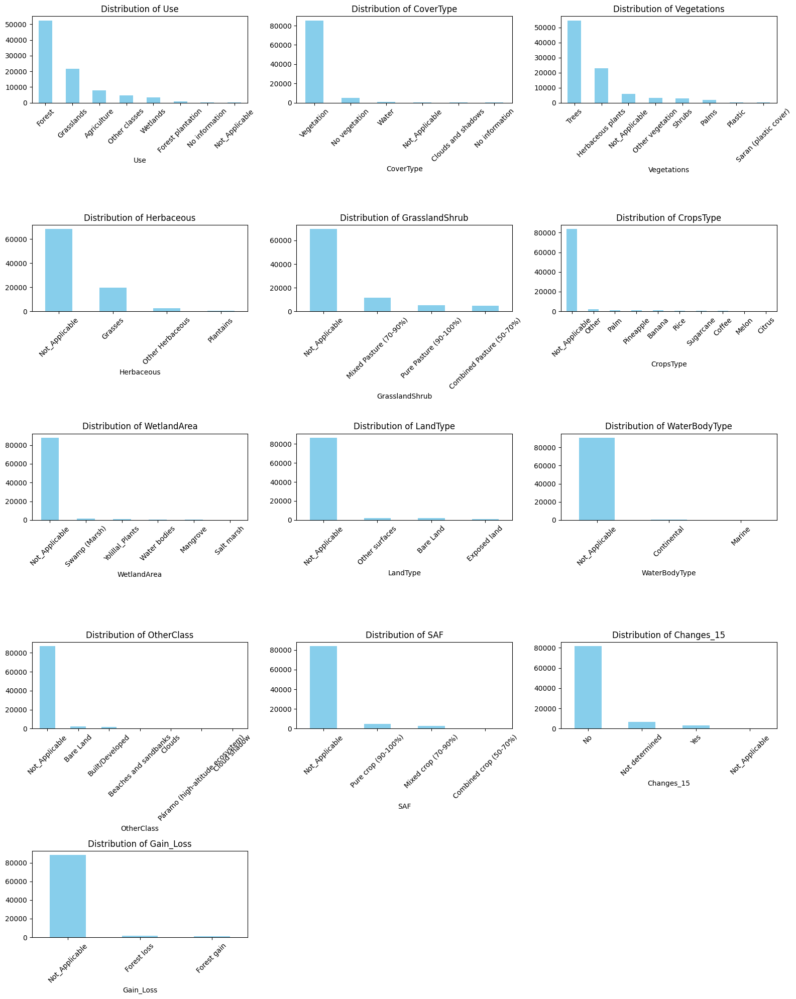

In [76]:
import matplotlib.pyplot as plt

# list of your 13 categorical columns
categorical_cols = [
    'Use', 'CoverType', 'Vegetations', 'Herbaceous', 'GrasslandShrub',
    'CropsType', 'WetlandArea', 'LandType', 'WaterBodyType',
    'OtherClass', 'SAF', 'Changes_15', 'Gain_Loss'
]

# set up the figure: 5 rows x 3 columns
fig, axes = plt.subplots(nrows=5, ncols=3, figsize=(16, 20))
axes = axes.flatten()  # Flatten the 2D array of axes for easy looping

# plot each categorical variable
for i, col in enumerate(categorical_cols):
    gdf4[col].value_counts().plot(kind='bar', ax=axes[i], color='skyblue')
    axes[i].set_title(f'Distribution of {col}')
    axes[i].tick_params(axis='x', rotation=45)

# hide any unused subplots if there are fewer than 15
for j in range(len(categorical_cols), len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()


### Numeric Distributiosn

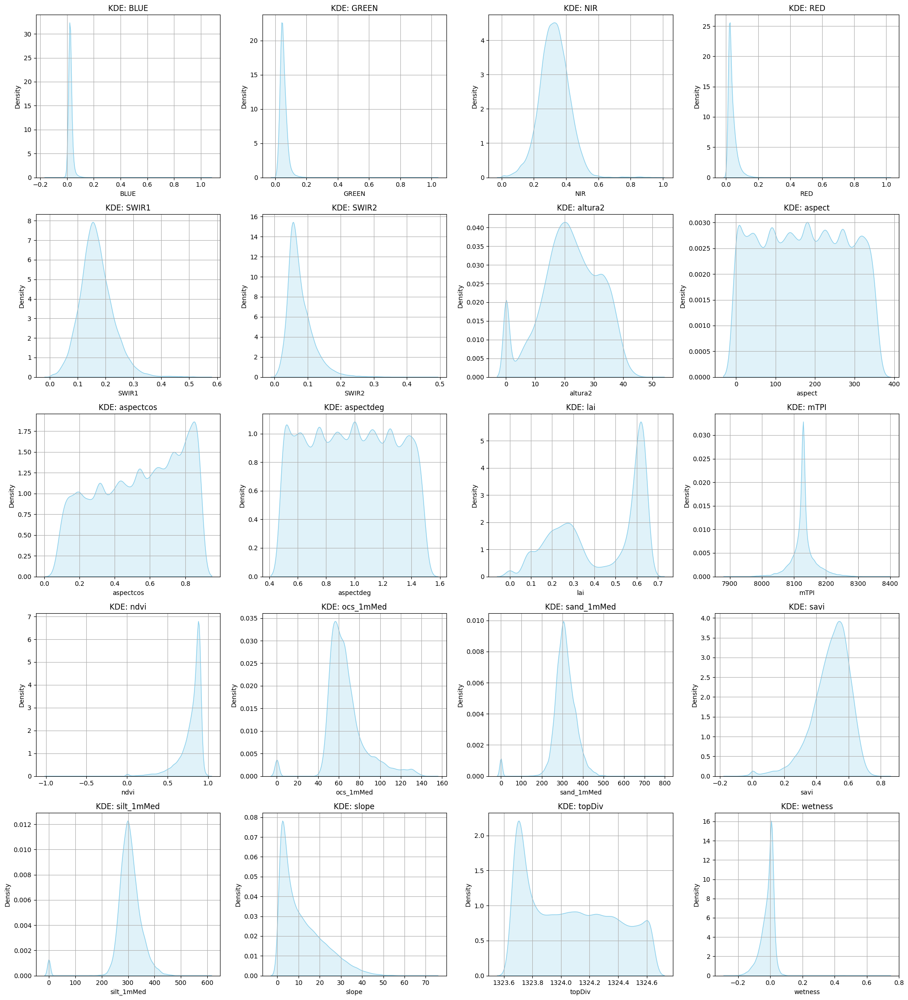

In [77]:
import matplotlib.pyplot as plt
import seaborn as sns

# List of your numerical columns
numeric_cols = [
    'BLUE', 'GREEN', 'NIR', 'RED', 'SWIR1', 'SWIR2', 'altura2', 'aspect', 'aspectcos', 'aspectdeg',
    'lai', 'mTPI', 'ndvi', 'ocs_1mMed', 'sand_1mMed', 'savi', 'silt_1mMed', 'slope', 'topDiv', 'wetness'
]

# Create 5x4 subplots
n_rows, n_cols = 5, 4
fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20, 22))
axes = axes.flatten()

for i, col in enumerate(numeric_cols):
    ax = axes[i]
    
    # Check for unique values to decide between hist or kde
    if gdf4[col].nunique() > 20:
        sns.kdeplot(gdf4[col].dropna(), ax=ax, fill=True, color='skyblue')
        ax.set_title(f"KDE: {col}")
    else:
        gdf4[col].plot(kind='hist', bins=30, ax=ax, color='lightcoral', alpha=0.7)
        ax.set_title(f"Histogram: {col}")
    
    ax.grid(True)

# Turn off any extra subplots
for j in range(len(numeric_cols), len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()


<Axes: >

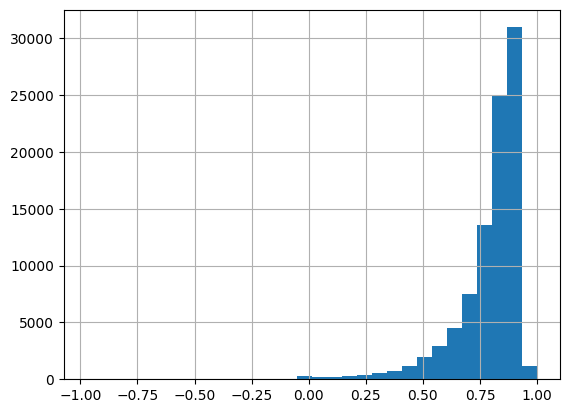

In [78]:
gdf4['ndvi'].hist(bins=30)

<Axes: ylabel='Density'>

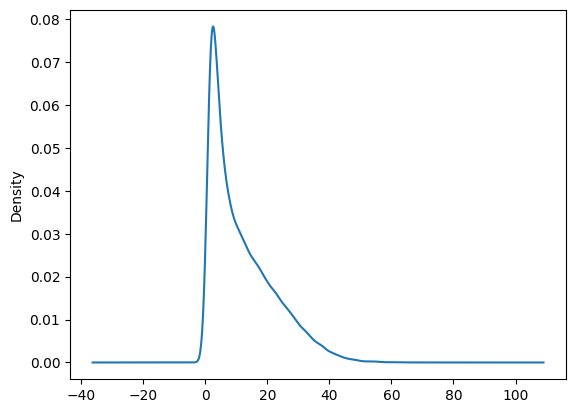

In [79]:
gdf4['slope'].plot(kind='kde')

### Correlation Heatmap

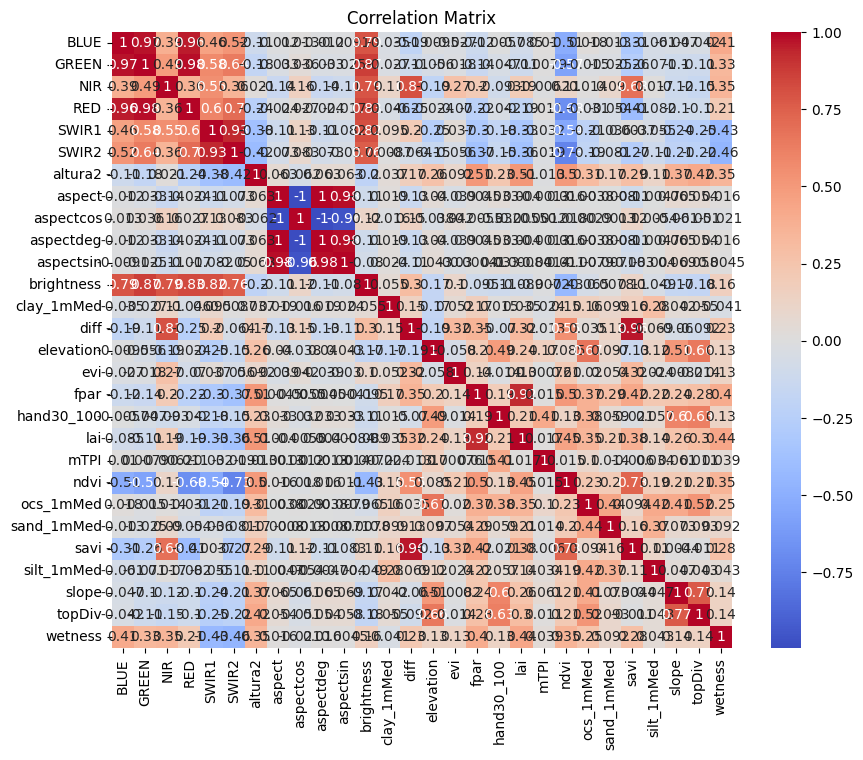

In [80]:
import seaborn as sns

plt.figure(figsize=(10, 8))
sns.heatmap(gdf4.corr(numeric_only=True), annot=True, cmap='coolwarm')
plt.title("Correlation Matrix")
plt.show()


### Group Insights

In [81]:
gdf4.groupby("Use")["ndvi"].mean().sort_values(ascending=False)

Use
Forest               0.840484
Forest plantation    0.795606
Not_Applicable       0.794549
Wetlands             0.738162
Grasslands           0.737885
Agriculture          0.735017
No information       0.663542
Other classes        0.587032
Name: ndvi, dtype: float64

### Scatter matrix
examining pairwise relationsips between numeric features to spot clusters, correlations, or outliers

array([[<Axes: xlabel='ndvi', ylabel='ndvi'>,
        <Axes: xlabel='savi', ylabel='ndvi'>,
        <Axes: xlabel='slope', ylabel='ndvi'>,
        <Axes: xlabel='lai', ylabel='ndvi'>],
       [<Axes: xlabel='ndvi', ylabel='savi'>,
        <Axes: xlabel='savi', ylabel='savi'>,
        <Axes: xlabel='slope', ylabel='savi'>,
        <Axes: xlabel='lai', ylabel='savi'>],
       [<Axes: xlabel='ndvi', ylabel='slope'>,
        <Axes: xlabel='savi', ylabel='slope'>,
        <Axes: xlabel='slope', ylabel='slope'>,
        <Axes: xlabel='lai', ylabel='slope'>],
       [<Axes: xlabel='ndvi', ylabel='lai'>,
        <Axes: xlabel='savi', ylabel='lai'>,
        <Axes: xlabel='slope', ylabel='lai'>,
        <Axes: xlabel='lai', ylabel='lai'>]], dtype=object)

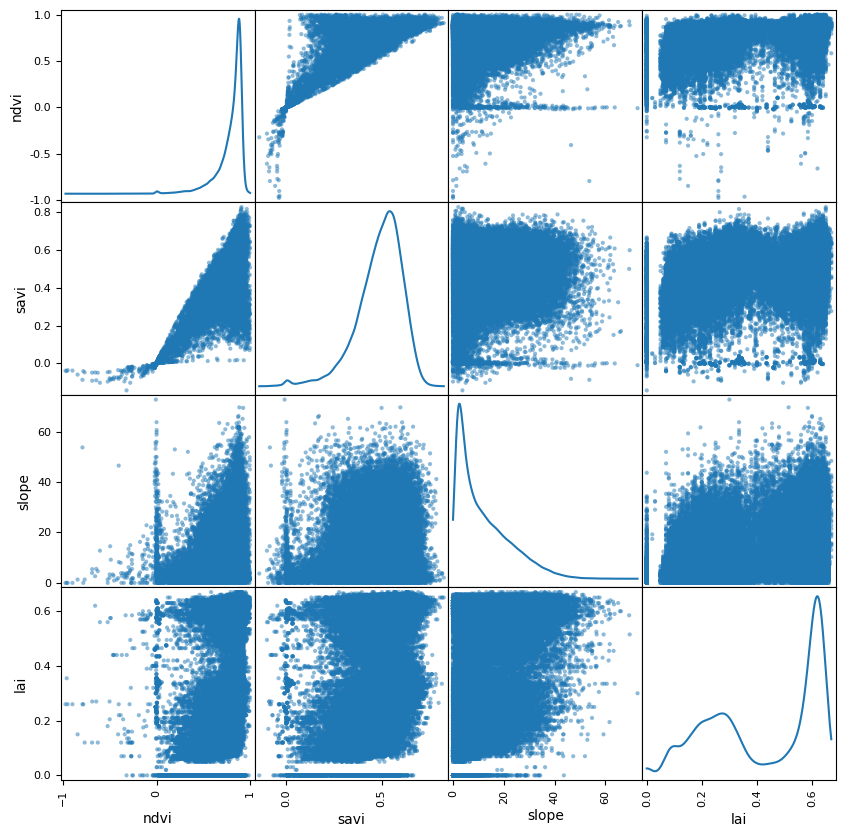

In [82]:
import pandas as pd
pd.plotting.scatter_matrix(
    gdf4[['ndvi', 'savi', 'slope', 'lai']],  # Pick 3–6 features
    figsize=(10, 10),
    diagonal='kde',  # or 'hist'
    alpha=0.5
)


### Outlier Detection by grouping
Viewing if NDVI varies by land use (Use) and detecting any outliers

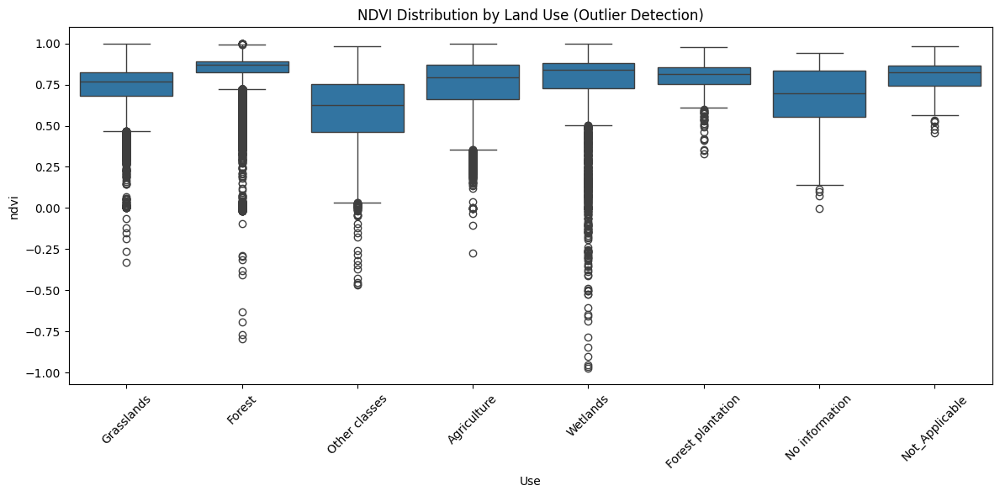

In [83]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))
sns.boxplot(data=gdf4, x='Use', y='ndvi')
plt.xticks(rotation=45)
plt.title("NDVI Distribution by Land Use (Outlier Detection)")
plt.tight_layout()
plt.show()


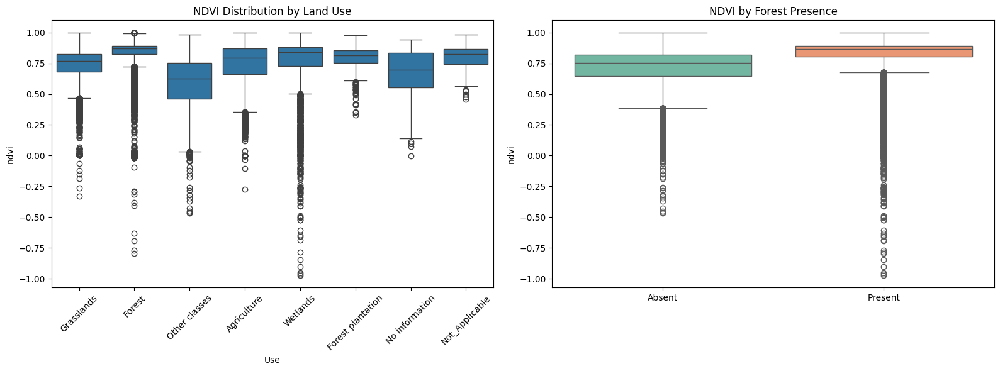

In [84]:
# Clean grouping: You may need to check for exact spelling
forest_like_classes = ['Forest', 'Agriculture', 'Forest plantation', 'Wetlands']

# Add column to gdf4 (your cleaned dataset)
gdf4['Forest_Presence'] = gdf4['Use'].apply(lambda x: 'Present' if x in forest_like_classes else 'Absent')

fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Original NDVI vs Use
sns.boxplot(data=gdf4, x='Use', y='ndvi', ax=axes[0])
axes[0].set_title("NDVI Distribution by Land Use")
axes[0].tick_params(axis='x', rotation=45)

# Simplified NDVI vs Forest_Presence
sns.boxplot(data=gdf4, x='Forest_Presence', y='ndvi', hue='Forest_Presence', palette='Set2', ax=axes[1], legend=False)
axes[1].set_title("NDVI by Forest Presence")
axes[1].set_xlabel("")

plt.tight_layout()
plt.show()


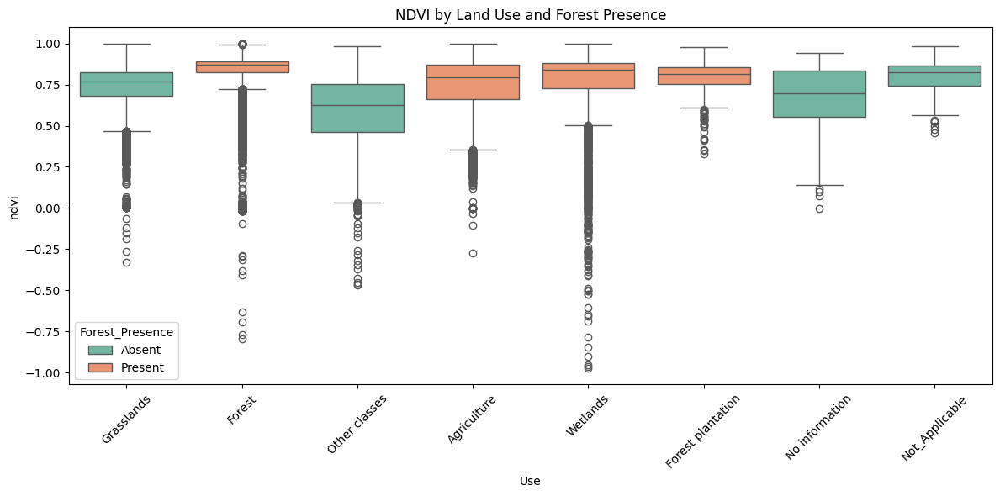

In [85]:
plt.figure(figsize=(12, 6))
sns.boxplot(data=gdf4, x='Use', y='ndvi', hue='Forest_Presence', palette='Set2')
plt.xticks(rotation=45)
plt.title("NDVI by Land Use and Forest Presence")
plt.tight_layout()
plt.show()


In [86]:
# Ensure the column exists first (if not already created)
forest_like_classes = ['Forest', 'Agriculture', 'Forest plantation', 'Wetlands']
gdf4['Forest_Presence'] = gdf4['Use'].apply(lambda x: 'Present' if x in forest_like_classes else 'Absent')

# Create the subset
forest_subset = gdf4[(gdf4['Forest_Presence'] == 'Present') & (gdf4['ndvi'] < 0.75)]

In [87]:
print(f"Subset size: {forest_subset.shape[0]}")
display(forest_subset[['Use', 'ndvi']].head())

Subset size: 9830


Use      ndvi
plotid sampleid                       
2      9              Forest  0.744990
7      29             Forest  0.648885
       32             Forest  0.677292
18     72             Forest  0.680213
23     92        Agriculture  0.719048

In [88]:
# # Subset where NDVI is between 0.5 and 1.0 (inclusive or exclusive as needed)
# ndvi_subset = gdf4[(gdf4['ndvi'] >= 0.5) & (gdf4['ndvi'] <= 1.0)]

## Performing PCA 

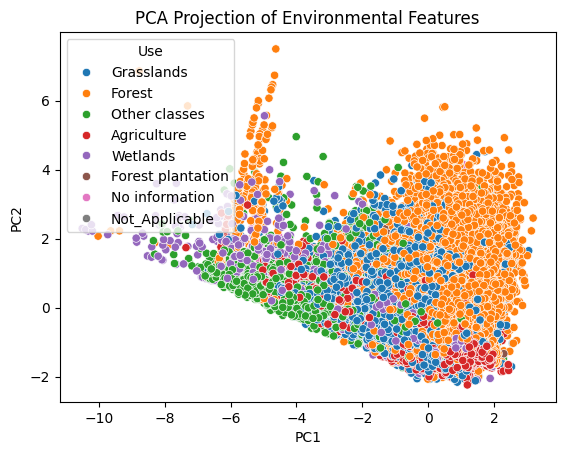

In [89]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import seaborn as sns

features = ['ndvi', 'savi', 'slope', 'lai']  # or more
X = gdf4[features].dropna()
X_scaled = StandardScaler().fit_transform(X)

pca = PCA(n_components=2)
pca_components = pca.fit_transform(X_scaled)

gdf4_pca = pd.DataFrame(pca_components, columns=['PC1', 'PC2'])
gdf4_pca['Use'] = gdf4['Use'].values[:len(gdf4_pca)]  # align labels

sns.scatterplot(data=gdf4_pca, x='PC1', y='PC2', hue='Use')
plt.title('PCA Projection of Environmental Features')
plt.show()


### PCA Summary of environmental features 
The PCA projection shows clear separation between certain land use types (e.g, Wetlands and Forest, Forest and other classes)  <br>
Interestingly there seems to be an overlapping between other classes and agriculture, glasslands, and welands and a couple Forests

### Defining Target and Features
We are trying to predict `Use` 

In [90]:
target_col = 'Use'

# define feature columns (used in PCA earlier)
feature_cols = [
    'BLUE', 'GREEN', 'NIR', 'RED', 'SWIR1', 'SWIR2',
    'altura2', 'aspect', 'aspectcos', 'aspectdeg',
    'lai', 'mTPI', 'ndvi', 'ocs_1mMed', 'sand_1mMed',
    'savi', 'silt_1mMed', 'slope', 'topDiv', 'wetness'
]

X = gdf4[feature_cols]
y = gdf4[target_col]

### Train/Test Split

In [91]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, stratify=y, random_state=42
)

### Applying Decision Trees to predict `Use`

In [92]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report, confusion_matrix

clf = DecisionTreeClassifier(max_depth=10, random_state=42)
clf.fit(X_train, y_train)

# Predict and evaluate
y_pred = clf.predict(X_test)
print(classification_report(y_test, y_pred))

                   precision    recall  f1-score   support

      Agriculture       0.66      0.44      0.52      1558
           Forest       0.82      0.88      0.85     10495
Forest plantation       0.17      0.01      0.02       167
       Grasslands       0.57      0.67      0.62      4349
   No information       0.00      0.00      0.00        44
   Not_Applicable       0.67      0.12      0.20        34
    Other classes       0.69      0.23      0.35       941
         Wetlands       0.65      0.52      0.57       697

         accuracy                           0.73     18285
        macro avg       0.53      0.36      0.39     18285
     weighted avg       0.73      0.73      0.72     18285



### Applying Random Forest to predict `Use`

In [93]:
from sklearn.ensemble import RandomForestClassifier

rf = RandomForestClassifier(n_estimators=100, random_state=42)
rf.fit(X_train, y_train)
y_rf_pred = rf.predict(X_test)
print(classification_report(y_test, y_rf_pred))

                   precision    recall  f1-score   support

      Agriculture       0.86      0.64      0.73      1558
           Forest       0.85      0.92      0.88     10495
Forest plantation       1.00      0.12      0.21       167
       Grasslands       0.69      0.73      0.71      4349
   No information       1.00      0.05      0.09        44
   Not_Applicable       1.00      0.21      0.34        34
    Other classes       0.76      0.40      0.53       941
         Wetlands       0.88      0.72      0.79       697

         accuracy                           0.81     18285
        macro avg       0.88      0.47      0.54     18285
     weighted avg       0.81      0.81      0.80     18285



### Applying SVM to predict `Use`
(this one took quite sometime to process but scored poorly)

In [94]:
from sklearn.svm import SVC

svc = SVC(kernel='rbf', C=1)
svc.fit(X_train, y_train)
y_svm_pred = svc.predict(X_test)
print(classification_report(y_test, y_svm_pred))

                   precision    recall  f1-score   support

      Agriculture       0.00      0.00      0.00      1558
           Forest       0.57      1.00      0.73     10495
Forest plantation       0.00      0.00      0.00       167
       Grasslands       0.00      0.00      0.00      4349
   No information       0.00      0.00      0.00        44
   Not_Applicable       0.00      0.00      0.00        34
    Other classes       0.00      0.00      0.00       941
         Wetlands       0.00      0.00      0.00       697

         accuracy                           0.57     18285
        macro avg       0.07      0.12      0.09     18285
     weighted avg       0.33      0.57      0.42     18285



/home/goldferret/Documents/projects/ndmn-notebooks/venv/lib/python3.13/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/goldferret/Documents/projects/ndmn-notebooks/venv/lib/python3.13/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/goldferret/Documents/projects/ndmn-notebooks/venv/lib/python3.13/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control th

### Plotting the above three models for comparison

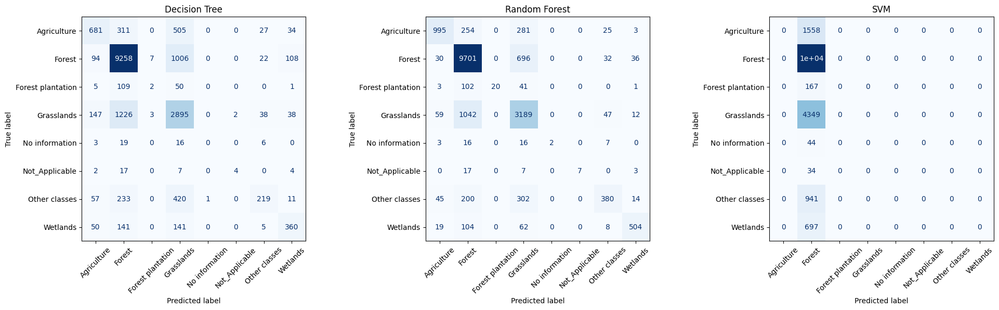

In [95]:
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay, confusion_matrix

# fit models (assuming these are already trained)
models = {
    "Decision Tree": clf,
    "Random Forest": rf,
    "SVM": svc
}

# prepare predictions
predictions = {
    name: model.predict(X_test)
    for name, model in models.items()
}

# plot
fig, axes = plt.subplots(1, 3, figsize=(20, 6))

for ax, (name, y_pred) in zip(axes, predictions.items()):
    cm = confusion_matrix(y_test, y_pred, labels=sorted(y.unique()))
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=sorted(y.unique()))
    disp.plot(ax=ax, xticks_rotation=45, cmap='Blues', colorbar=False)
    ax.set_title(name)

plt.tight_layout()
plt.show()


### Checking class ditributions (Imbalance?)
Could we be dealing with imbalanced classes, which could be the cultprits to making classifiers biased towards dominant categories like Forest

<Axes: title={'center': 'Class Distribution'}, ylabel='Use'>

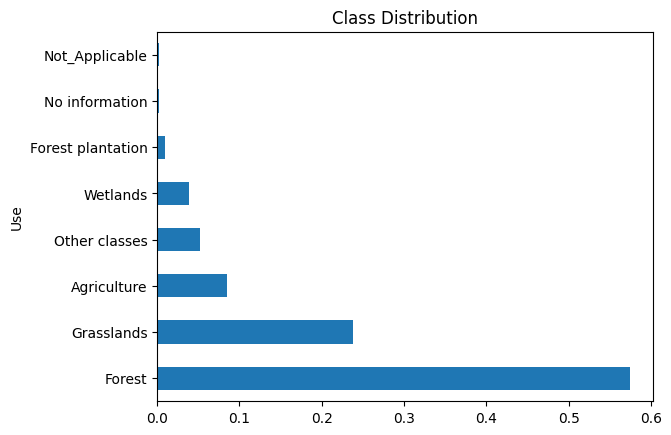

In [96]:
y.value_counts(normalize=True).plot(kind='barh', title='Class Distribution')

### Applying class weights (* especially since we are performing Decision Trees, RF, and SVM)

In [97]:
DecisionTreeClassifier(class_weight='balanced')

DecisionTreeClassifier(class_weight='balanced')

In [98]:
RandomForestClassifier(class_weight='balanced')

RandomForestClassifier(class_weight='balanced')

### Train the model

In [99]:
from sklearn.tree import DecisionTreeClassifier

clf = DecisionTreeClassifier(max_depth=10, class_weight='balanced', random_state=42)
clf.fit(X_train, y_train)

DecisionTreeClassifier(class_weight='balanced', max_depth=10, random_state=42)

In [100]:
y_pred = clf.predict(X_test)

In [101]:
from sklearn.metrics import classification_report

print(classification_report(y_test, y_pred))

                   precision    recall  f1-score   support

      Agriculture       0.49      0.54      0.51      1558
           Forest       0.90      0.61      0.72     10495
Forest plantation       0.05      0.62      0.09       167
       Grasslands       0.55      0.35      0.43      4349
   No information       0.02      0.50      0.04        44
   Not_Applicable       0.11      0.74      0.19        34
    Other classes       0.24      0.51      0.32       941
         Wetlands       0.40      0.74      0.52       697

         accuracy                           0.54     18285
        macro avg       0.34      0.57      0.35     18285
     weighted avg       0.72      0.54      0.60     18285



### Another alternative for imbalance classes: Resampling

In [102]:
# !pip install imbalanced-learn
from imblearn.over_sampling import SMOTE

# Apply only on the training set
smote = SMOTE(random_state=42)
X_train_res, y_train_res = smote.fit_resample(X_train, y_train)

# Fit on resampled data
clf_smote = DecisionTreeClassifier(max_depth=10, random_state=42)
clf_smote.fit(X_train_res, y_train_res)

# Evaluate
print(classification_report(y_test, clf_smote.predict(X_test)))


ModuleNotFoundError: No module named 'imblearn'

## Machine Learning Application